In [137]:
import pandas as pd
import plotly.express as px
import osmnx as ox
import geopandas as gpd

In [138]:
'''
The code below was the initial read of the data.
As the code takes quite some time to run (as it gets rid of all crashes not in manhatten) 
It was easier to save the file to a pickle afterwards and just work with that pickle file


df = pd.read_csv('Motor_Vehicle_Collisions_-_Crashes.csv', on_bad_lines='skip', sep=';')
df = df.dropna(subset=['LATITUDE'])
city = ox.geocode_to_gdf('Manhattan, New York City, New York, USA')
manhattan_polygon = city.geometry.iloc[0]
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.LONGITUDE, df.LATITUDE), crs='EPSG:4326')
gdf = gdf[gdf.geometry.within(manhattan_polygon)]

'''
df = pd.read_pickle('gdf_pickle.pkl')

#removing all chrashes that is not geotagged
df = df.dropna(subset=['LATITUDE'])
df['BOROUGH'] = 'MANHATTAN'
df['latitude'] = df['LATITUDE']
df['longitude'] = df['LONGITUDE']
df['date'] = pd.to_datetime(df['CRASH DATE'])
df['time'] = pd.to_datetime(df['CRASH TIME'])
df['month'] = df['date'].dt.month_name()
df['year'] = df['date'].dt.year
df['weekday'] = df['date'].apply(lambda x: x.strftime('%A'))
#only taking the data from 2013-2022 as 2023 is incomplete. 
mask = (df['date'] > '12/31/2012') & (df['date'] <= '12/31/2022')
df = df.loc[mask]
# adding an id so that plotly gets a location for each crash

df['id'] = range(len(df))

#reading in the weather data
df_weather = pd.read_excel('open-meteo-40.70N74.00W27m.xlsx')
df_weather['date'] = df_weather['time']
del df_weather['time']

#Merging the dataframes so each crash has the weatherdata for that day. 
df = pd.merge(df, df_weather, on='date', how='left')

In [139]:
df

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,time,month,year,weekday,id,temperature_2m_mean (°C),rain_sum (mm),snowfall_sum (cm),windspeed_10m_max (km/h),windgusts_10m_max (km/h)
0,12/14/2021,14:58,MANHATTAN,10017.0,40.751440,-73.973970,"(40.75144, -73.97397)",3 AVENUE,EAST 43 STREET,NaN,...,2023-04-06 14:58:00,December,2021,Tuesday,0,5.212500,0.000000,0.00,15.3,27.0
1,12/11/2021,4:45,MANHATTAN,10001.0,40.748917,-73.993546,"(40.748917, -73.993546)",NaN,NaN,232 WEST 30 STREET,...,2023-04-06 04:45:00,December,2021,Saturday,1,11.712501,7.900000,0.00,28.6,81.7
2,12/14/2021,3:43,MANHATTAN,NaN,40.804375,-73.937420,"(40.804375, -73.93742)",LEXINGTON AVENUE,NaN,NaN,...,2023-04-06 03:43:00,December,2021,Tuesday,2,5.212500,0.000000,0.00,15.3,27.0
3,12/14/2021,16:25,MANHATTAN,NaN,40.784615,-73.953964,"(40.784615, -73.953964)",EAST 93 STREET,NaN,NaN,...,2023-04-06 16:25:00,December,2021,Tuesday,3,5.212500,0.000000,0.00,15.3,27.0
4,04/22/2022,17:17,MANHATTAN,NaN,40.790276,-73.939600,"(40.790276, -73.9396)",EAST 107 STREET,NaN,NaN,...,2023-04-06 17:17:00,April,2022,Friday,4,13.412498,0.000000,0.00,19.1,35.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
352085,02/17/2022,7:50,MANHATTAN,10012.0,40.720320,-73.994050,"(40.72032, -73.99405)",BOWERY,KENMARE STREET,NaN,...,2023-04-06 07:50:00,February,2022,Thursday,352085,10.075001,1.000000,0.00,25.6,49.7
352086,09/04/2022,2:42,MANHATTAN,10031.0,40.828297,-73.950870,"(40.828297, -73.95087)",RIVERSIDE DRIVE,WEST 147 STREET,NaN,...,2023-04-06 02:42:00,September,2022,Sunday,352086,24.574999,0.700000,0.00,9.4,18.4
352087,12/07/2022,7:41,MANHATTAN,NaN,40.862923,-73.927770,"(40.862923, -73.92777)",SHERMAN AVENUE,NaN,NaN,...,2023-04-06 07:41:00,December,2022,Wednesday,352087,12.529166,13.400001,0.00,16.0,36.7
352088,03/01/2022,19:05,MANHATTAN,10034.0,40.863690,-73.917070,"(40.86369, -73.91707)",WEST 207 STREET,9 AVENUE,NaN,...,2023-04-06 19:05:00,March,2022,Tuesday,352088,2.050000,0.400000,0.00,18.0,32.4


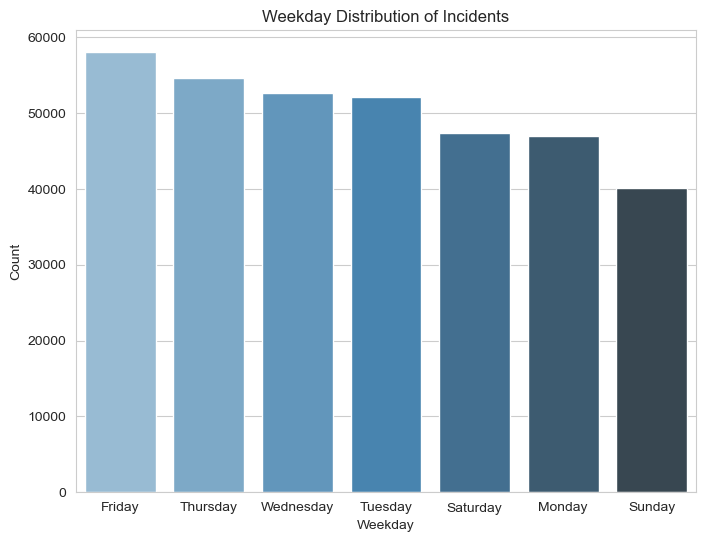

In [110]:
import seaborn as sns
import matplotlib.pyplot as plt
weekday_count = df['weekday'].value_counts()

# Create bar plot of weekday distribution
sns.set_style('whitegrid')
plt.figure(figsize=(8, 6))
ax = sns.barplot(x=weekday_count.index, y=weekday_count.values, palette='Blues_d')
ax.set_title('Weekday Distribution of Incidents')
ax.set_xlabel('Weekday')
ax.set_ylabel('Count')
plt.show()

In [118]:
import numpy as np

dftemp = df.loc[df['CONTRIBUTING FACTOR VEHICLE 1'] == 'Alcohol Involvement']

def animate_map(time_col):
    fig = px.scatter_mapbox(df,
              lat="latitude" ,
              lon="longitude",
              hover_name="BOROUGH",
              color="CONTRIBUTING FACTOR VEHICLE 1",
              animation_frame=time_col,
              mapbox_style='carto-positron',
              category_orders={
              time_col:list(np.sort(sample_df[time_col].unique()))
              },                  
              zoom=10)
    fig.update_layout(
    autosize=False,
    width=1500,
    height=1000,)
    fig.show()

    pyo.plot(fig, filename='vehicle_crashes_map.html', auto_play=False)
animate_map(time_col='year')